# Import

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import scanpy as sc
import os

import matplotlib.pyplot as plt

sc.settings.n_jobs = 16
sc.settings.set_figure_params(dpi=180, dpi_save=300, frameon=False, figsize=(4, 4), fontsize=8, facecolor='white')

# Define output

In [2]:
overwrite = True

output_folder = r'output_folder'

preprocess_name = 'MeCP2_preprocessed_adata.h5ad'
cluster_name = 'MeCP2_clustered_adata.h5ad'

# Load adata

In [3]:
adata = sc.read_h5ad(os.path.join(output_folder, 'MeCP2_raw_adata.h5ad'))
original_cell_count = len(adata)

# Preprocess and filter

In [4]:
# Calculate quality control metrics
sc.pp.calculate_qc_metrics(adata, percent_top=None, log1p=False, inplace=True)

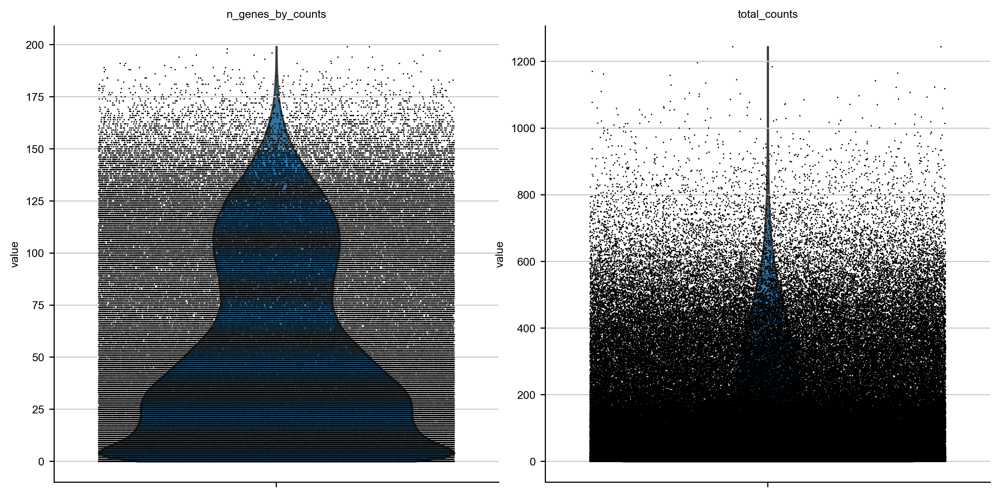

In [5]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

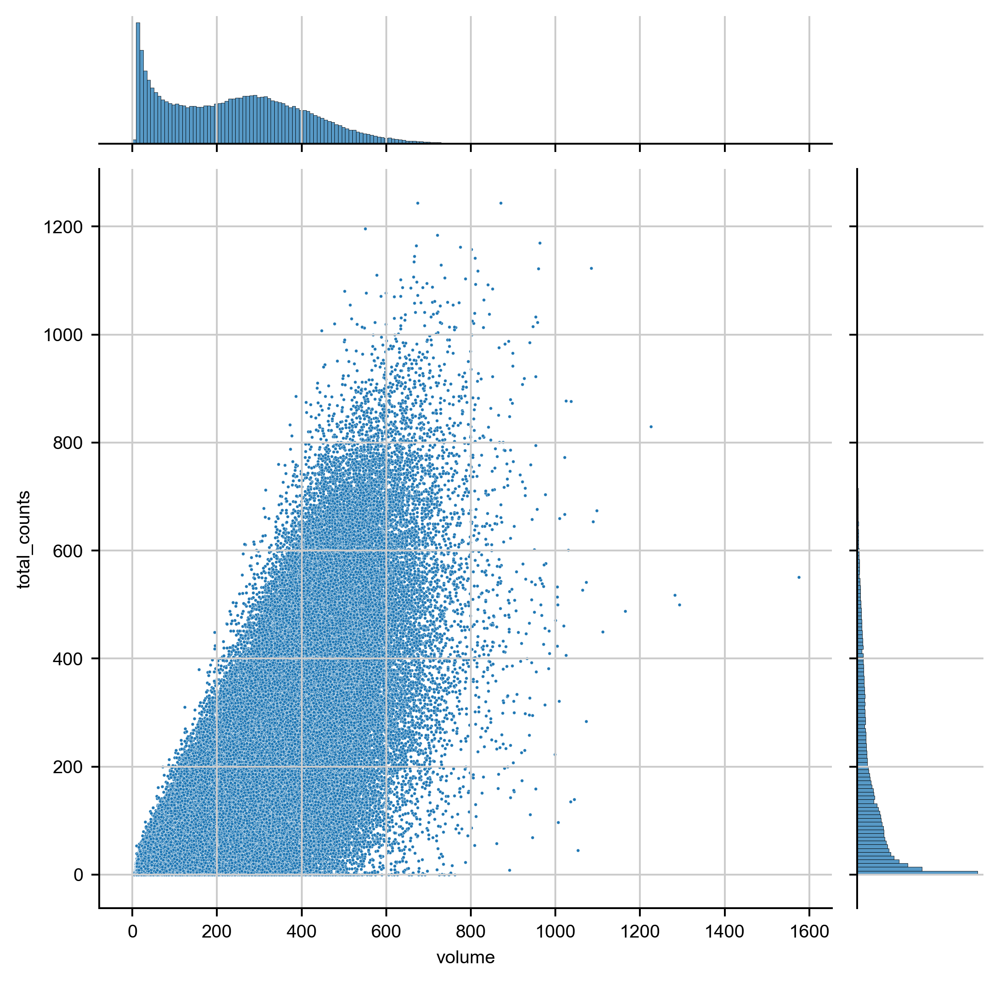

In [6]:
sns.jointplot(data=adata.obs, x='volume', y='total_counts', s=2)

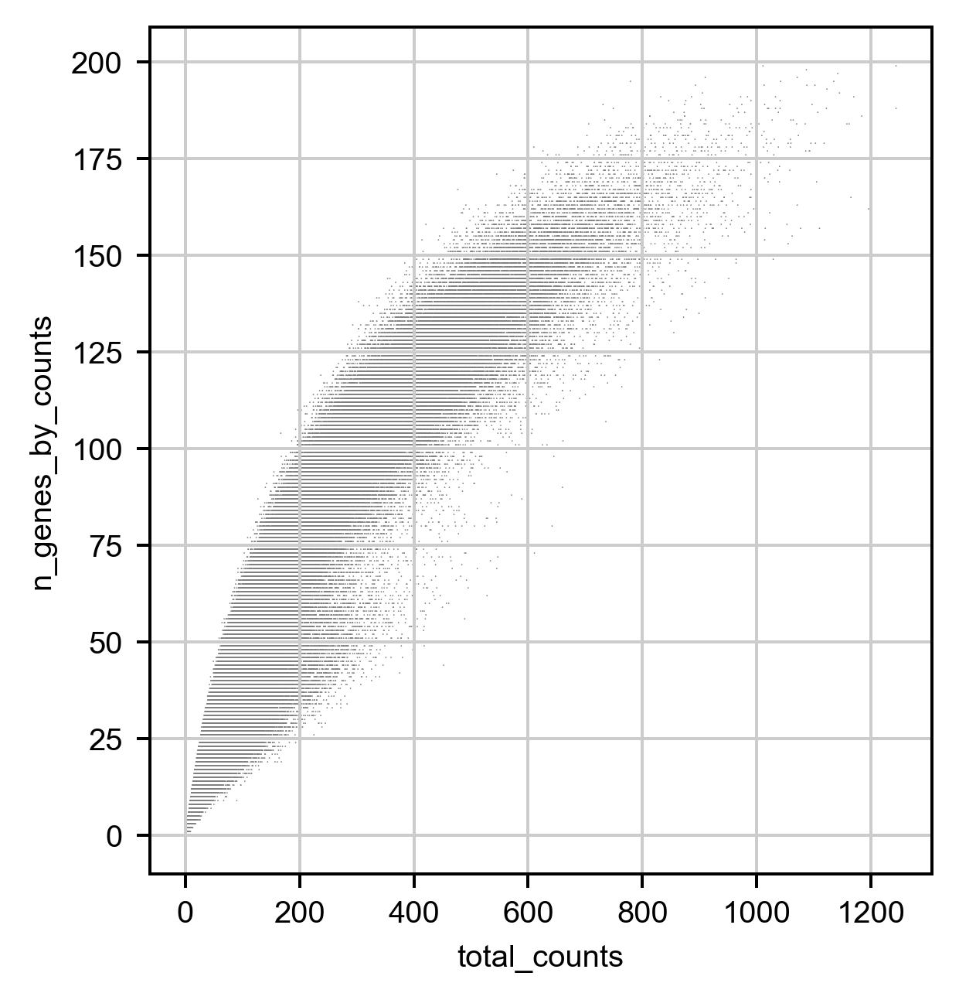

In [7]:
# Plot the distributions of gene counts
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [8]:
gene_count_threshold = 20
total_count_threshold = 50
volume_threshold = 100
volume_upper_threshold = 800

# Filtering
adata = adata[adata.obs['n_genes_by_counts'] > gene_count_threshold]
adata = adata[adata.obs['total_counts'] > total_count_threshold]
adata = adata[adata.obs['volume'] > volume_threshold]
adata = adata[adata.obs['volume'] <= volume_upper_threshold]

filtered_cell_count = len(adata.obs)
print(f'{filtered_cell_count} cells are kept out of {original_cell_count} cells')
print(f'{filtered_cell_count/original_cell_count*100}% is kept')

152286 cells are kept out of 243151 cells
62.63021743690135% is kept


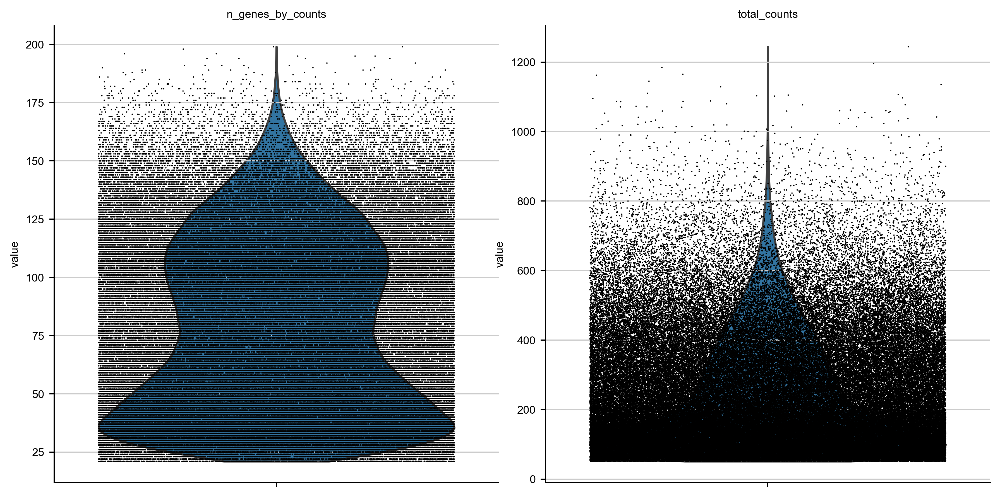

In [9]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

In [10]:
total_counts = np.mean(adata.obs['total_counts'])
print(f'mean total count is {total_counts}')

mean total count is 244.8316192626953


In [11]:
if overwrite:
    save_filename = os.path.join(output_folder, preprocess_name)
    adata.write_h5ad(save_filename)
    print(f'Saving preprocessed adata to {save_filename}')

Saving preprocessed adata to C:\Users\cosmosyw\Documents\Research\Mecp2_v2\results\adata\MeCP2_preprocessed_adata.h5ad


# Clustering

C:\Users\cosmosyw\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


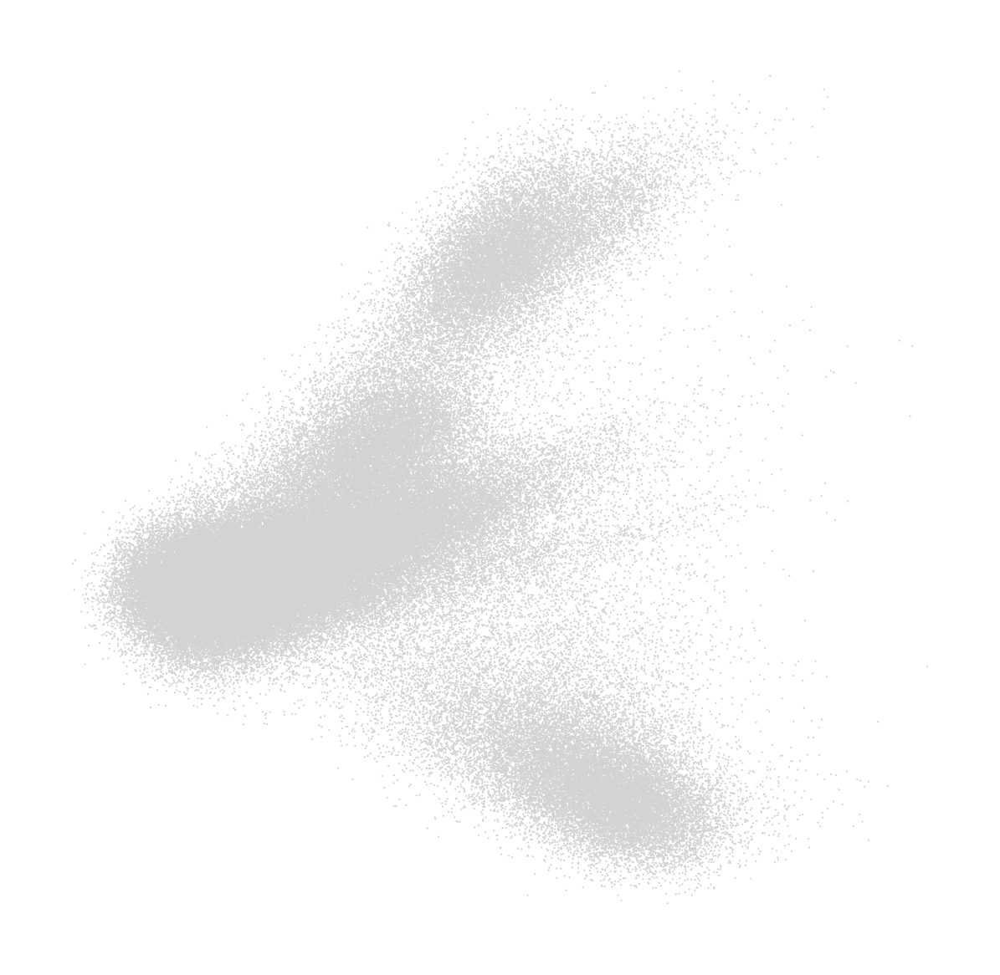

CPU times: total: 52.7 s
Wall time: 16.3 s


In [12]:
%%time
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
sc.pp.normalize_total(adata, target_sum=100)
# Logarithmize the data
sc.pp.log1p(adata)
# Regress out total counts
sc.pp.regress_out(adata, 'total_counts')
# Convert gene expressions to Z-scores
sc.pp.scale(adata, max_value=10)
# Principal component analysis
sc.tl.pca(adata, svd_solver='arpack')
# Plot the PCA results
sc.pl.pca(adata)

In [13]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=50)

CPU times: total: 45.6 s
Wall time: 18.1 s


In [14]:
%%time
# Clustering
sc.tl.leiden(adata, resolution=1)

CPU times: total: 26.7 s
Wall time: 26.7 s


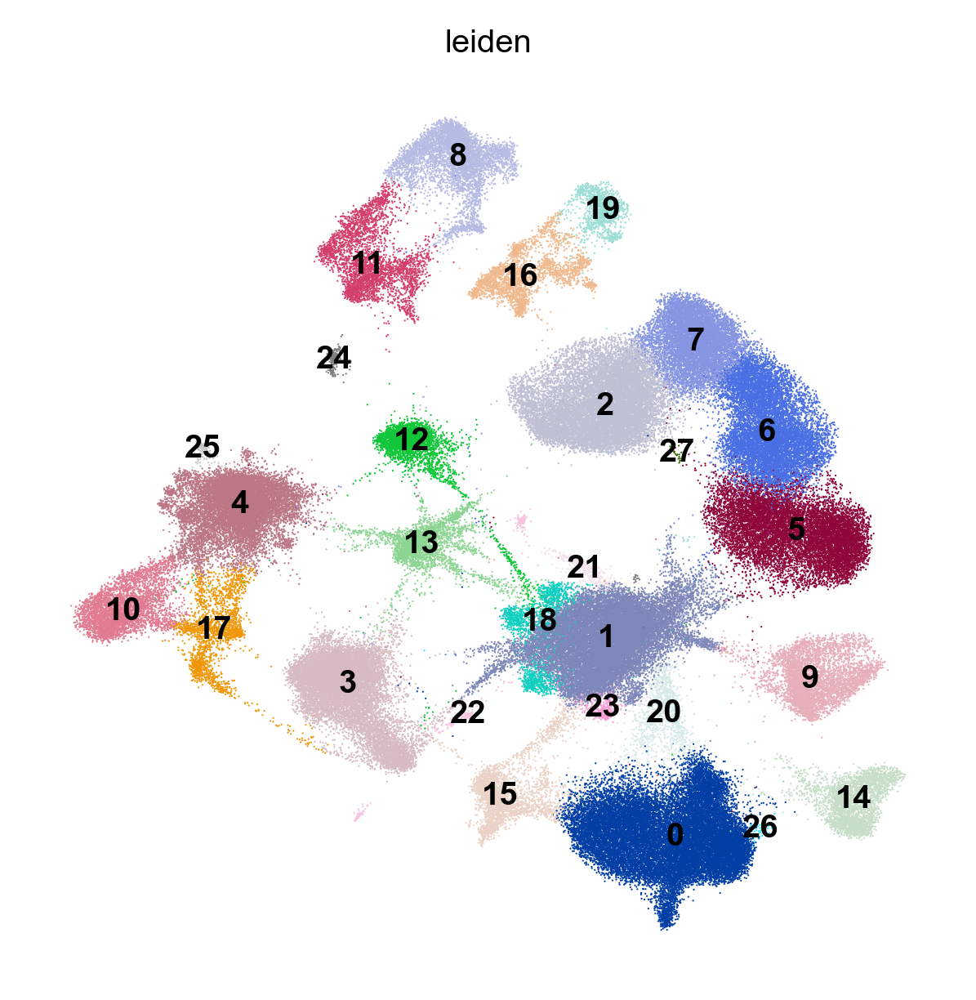

CPU times: total: 4min 42s
Wall time: 1min 8s


In [15]:
%%time
# Embed with UMAP
sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='leiden', legend_loc='on data')

(-6373.172603910789, -562.3916100952774, -940.1491952009499, 3456.137103318423)

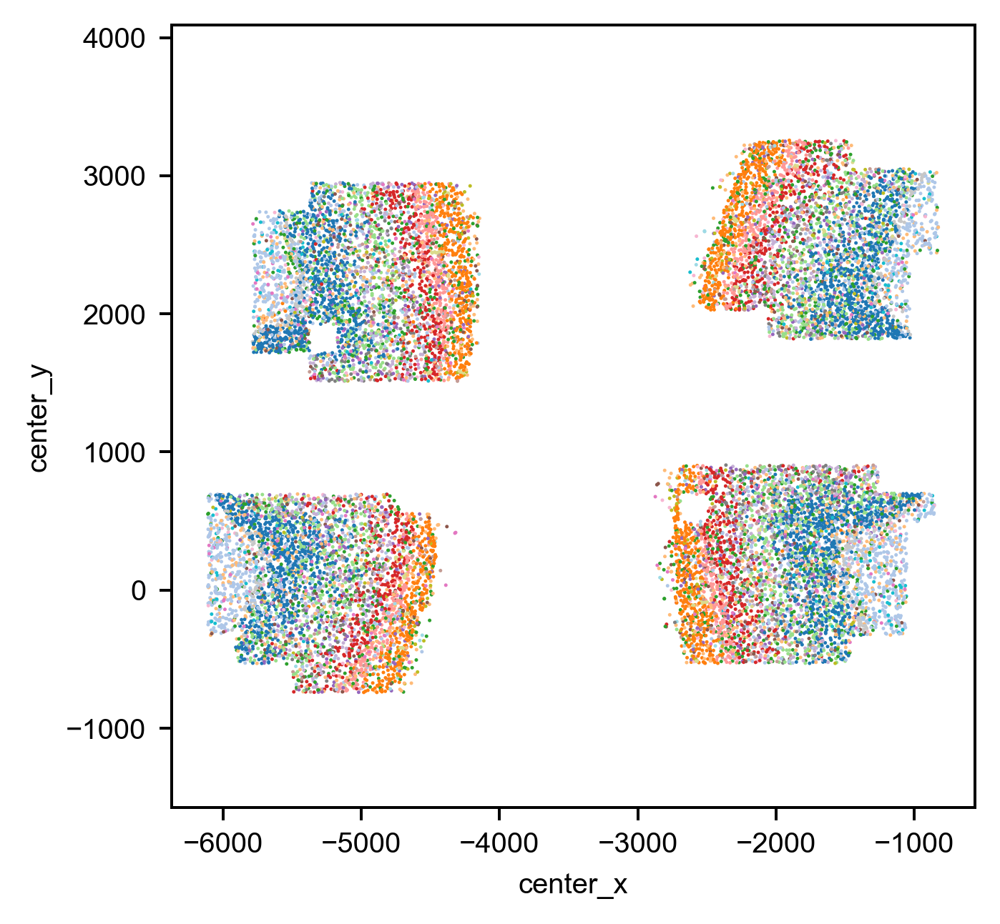

In [16]:
# visualzie the spatial dist for clusters
import matplotlib.pyplot as plt

sel_exp = '1101'
_cell_plot = adata.obs[adata.obs['experiment']==sel_exp].copy()

ax = sns.scatterplot(data=_cell_plot, x='center_x', y='center_y', palette='tab20', hue='leiden',
                    s=1, legend=False, linewidth=0)

ax.grid(False)
plt.axis('equal')


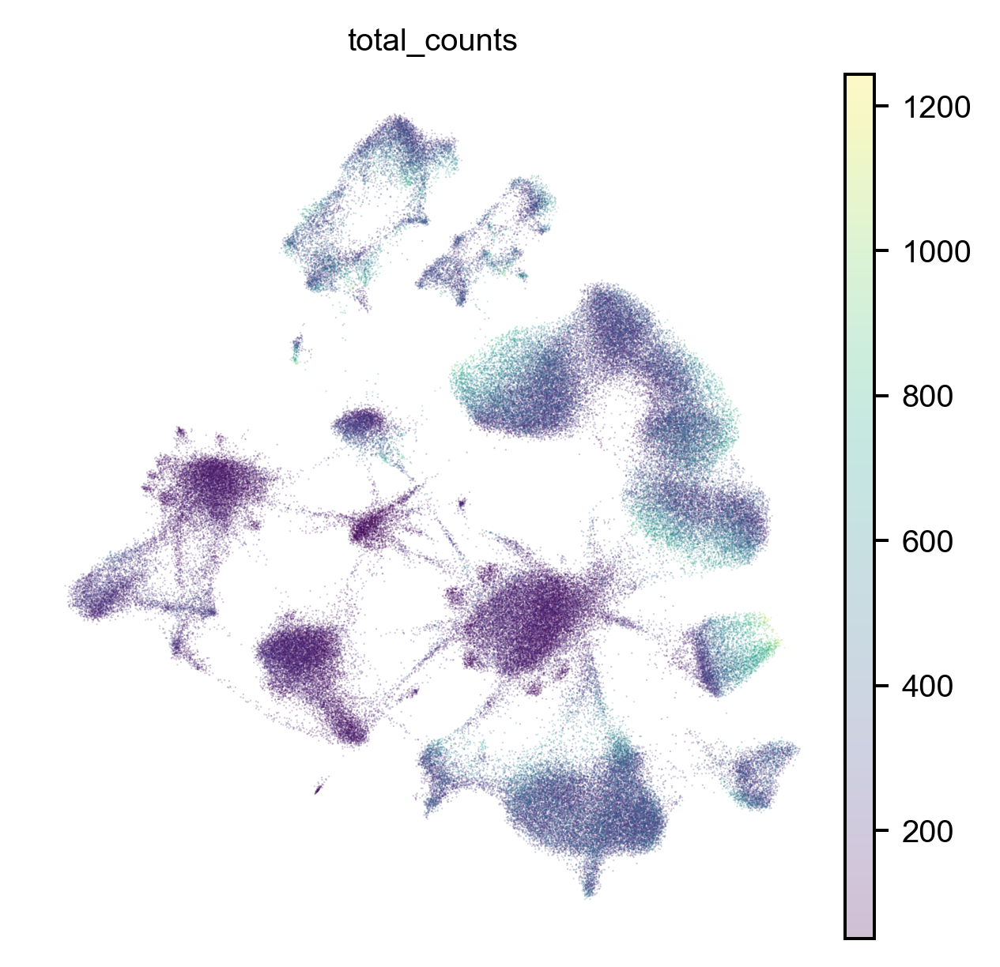

In [17]:
sc.pl.umap(adata, color='total_counts', alpha=0.25)

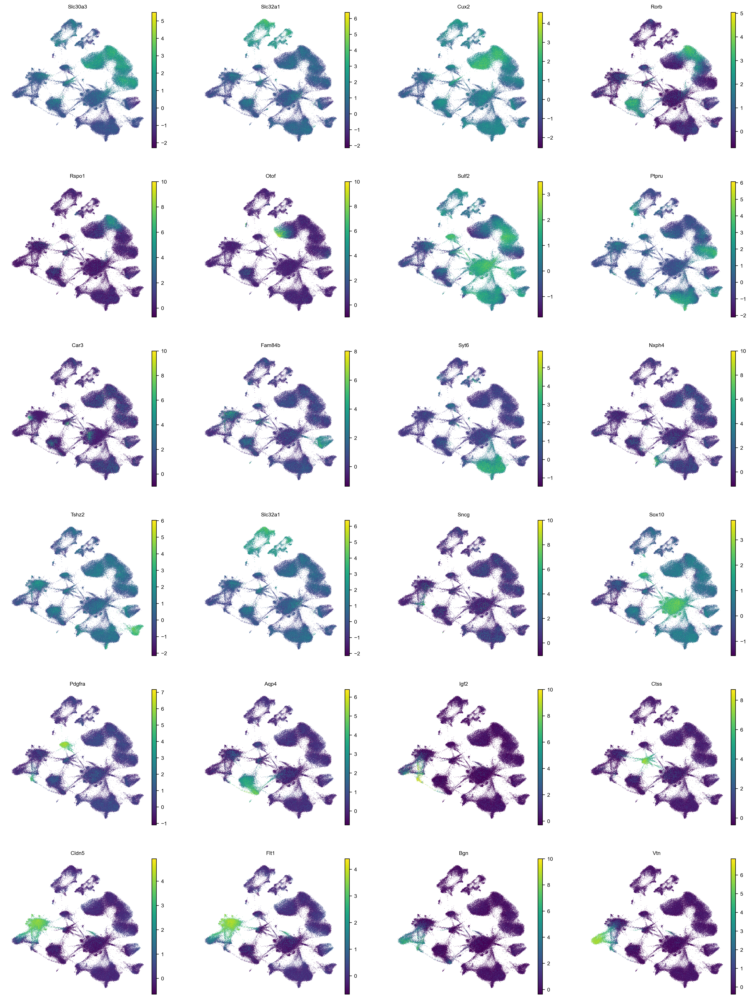

In [18]:
# 
marker_genes = ['Slc17a7', 'Slc30a3', 'Slc32a1', 'Cux2', 'Rorb', 'Rspo1','Otof','Sulf2', 'Ptpru', 'Car3', 'Fam84b', 'Syt6', 
               'Nxph4', 'Tshz2', 'Slc32a1', 'Pvalb', 'Sst', 'Vip', 'Sncg', 'Lamp5', 'Sox10', 'Pdgfra', 'Aqp4', 'Igf2',
               'Ctss', 'Cldn5', 'Flt1', 'Bgn', 'Vtn']
marker_genes = [g for g in marker_genes if (g in adata.var.index)]
sc.pl.umap(adata, color=marker_genes)

In [19]:
###################### save the clustered adata ####################################
if overwrite:
    save_filename = os.path.join(output_folder, cluster_name)
    adata.write_h5ad(save_filename)
    print(f'Saving clustered adata to {save_filename}')

Saving clustered adata to C:\Users\cosmosyw\Documents\Research\Mecp2_v2\results\adata\MeCP2_clustered_adata.h5ad
